In [1]:
from dask.distributed import Client, LocalCluster
from dask import delayed, dataframe as dd
import dask

import pandas as pd
import geopandas as gpd
import math
import numpy as np

import momepy
from scripts.tessellation import enclosed_tessellation

import matplotlib.pyplot as plt

/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/dask/dataframe/_pyarrow_compat.py:17: FutureWarning: Minimal version of pyarrow will soon be increased to 14.0.1. You are using 13.0.0. Please consider upgrading.
  warnings.warn(


In [2]:
place = "glasgow"
local_crs = 27700

In [3]:
Daskcluster = LocalCluster(threads_per_worker=2,
                n_workers=8, memory_limit='100GB')

client = Client(Daskcluster)
client

/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/distributed/node.py:182: UserWarning: Port 8787 is already in use.
Perhaps you already have a cluster running?
Hosting the HTTP server on port 34507 instead
  warnings.warn(
2023-11-27 12:41:23,569 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-27 12:41:23,572 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-27 12:41:23,575 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-27 12:41:23,578 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-27 12:41:23,581 - distributed.nanny.memory - WARNING - Ignoring provided memory limit 100GB due to system memory limit of 31.31 GiB
2023-11-27 12:41:23,583 - distributed.nanny.me

Connection method: Cluster object,Cluster type: distributed.LocalCluster
Dashboard: http://127.0.0.1:34507/status,
Dashboard: http://127.0.0.1:34507/status,Workers: 8
Total threads: 16,Total memory: 250.47 GiB
Status: running,Using processes: True
Comm: tcp://127.0.0.1:41727,Workers: 8
Dashboard: http://127.0.0.1:34507/status,Total threads: 16
Started: Just now,Total memory: 250.47 GiB
Comm: tcp://127.0.0.1:33553,Total threads: 2
Dashboard: http://127.0.0.1:46417/status,Memory: 31.31 GiB
Nanny: tcp://127.0.0.1:40429,


In [4]:
streets = gpd.read_parquet(f"./output/{place}/streets_raw.pq").explode().to_crs(local_crs).reset_index(drop=True)

buildings = gpd.read_parquet(f"./output/{place}/buildings_raw.pq").to_crs(local_crs)

study_area = gpd.read_parquet(f"./output/{place}/study_area.pq").to_crs(local_crs)

water = gpd.read_parquet(f"./output/{place}/water.pq").to_crs(local_crs)

/tmp/ipykernel_26341/3775211364.py:1: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  streets = gpd.read_parquet(f"./output/{place}/streets_raw.pq").explode().to_crs(local_crs).reset_index(drop=True)


In [5]:
streets[~streets['geometry'].is_valid]

,geometry


In [6]:
buildings[~buildings['geometry'].is_valid]

,geometry,meanHeight,RegionName,quadkey,index_right
1622,"POLYGON ((245313.377 702215.681, 245310.213 70...",-1.0,UnitedKingdom,31133221,0
25485,"POLYGON ((257150.177 664898.782, 257140.113 66...",-1.0,UnitedKingdom,31133223,0
95400,"POLYGON ((287309.206 692567.319, 287337.832 69...",-1.0,UnitedKingdom,31133232,0
123305,"POLYGON ((287835.747 680017.835, 287836.533 68...",-1.0,UnitedKingdom,31133232,0
160760,"POLYGON ((292441.112 681887.028, 292363.312 68...",-1.0,UnitedKingdom,31133232,0
196585,"POLYGON ((264995.445 660153.445, 264989.845 66...",-1.0,UnitedKingdom,31133232,0
203814,"POLYGON ((294232.271 681879.912, 294227.072 68...",-1.0,UnitedKingdom,31133232,0
249659,"POLYGON ((262448.559 660310.416, 262449.199 66...",-1.0,UnitedKingdom,31133232,0
253998,"POLYGON ((264449.744 660495.303, 264469.408 66...",-1.0,UnitedKingdom,31133232,0
273973,"POLYGON ((273192.756 665784.284, 273192.725 66...",-1.0,UnitedKingdom,31133232,0


In [7]:
water[~water['geometry'].is_valid]

,,geometry
element_type,osmid,


In [13]:
buildings = momepy.preprocess(buildings.reset_index(), size=30,
                              compactness=0.2, islands=True)

Loop 1 out of 2.


/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/momepy/preprocessing.py:89: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  sw = libpysal.weights.contiguity.Rook.from_dataframe(blg, silence_warnings=True)


Identifying changes:   0%|          | 0/475896 [00:00<?, ?it/s]

Changing geometry: 0it [00:00, ?it/s]

Loop 2 out of 2.


/home/virgilxw/miniconda3/envs/morph_model_v1_tess/lib/python3.11/site-packages/momepy/preprocessing.py:89: FutureWarning: `use_index` defaults to False but will default to True in future. Set True/False directly to control this behavior and silence this warning
  sw = libpysal.weights.contiguity.Rook.from_dataframe(blg, silence_warnings=True)


Identifying changes:   0%|          | 0/475894 [00:00<?, ?it/s]

Changing geometry: 0it [00:00, ?it/s]

In [9]:
# Check for invalid geometries
invalid_geometries = buildings[~buildings.geometry.is_valid]

# If there are invalid geometries, attempt to fix them
if not invalid_geometries.empty:
    print(f"Found {len(invalid_geometries)} invalid geometries. Attempting to fix...")
    buildings.geometry = buildings.geometry.buffer(0)

    # Recheck for invalid geometries
    still_invalid = buildings[~buildings.geometry.is_valid]
    if still_invalid.empty:
        print("All invalid geometries fixed.")
    else:
        print(f"Could not fix {len(still_invalid)} geometries.")
else:
    print("No invalid geometries found.")

Found 12 invalid geometries. Attempting to fix...
All invalid geometries fixed.


In [10]:
buildings['uID'] = momepy.unique_id(buildings)

In [11]:
water_bodies_boundaries = []

# Explode the GeoDataFrame into a GeoSeries of polygons and multipolygons
gs = water.explode()

# Convert each polygon into a MultiLineString
mls = gs.geometry.boundary

# Convert the MultiLineString into a DataFrame
water_bodies = gpd.GeoDataFrame({'geometry': mls})

for water_body in water_bodies.geometry:
    # Create a LineString object from the coordinates
    water_bodies_boundaries.append(water_body)

# # Create a GeoDataFrame of the water area boundaries
water_bodies_boundaries = gpd.GeoDataFrame({'geometry': water_bodies_boundaries}).reset_index(drop=True)

/tmp/ipykernel_26341/893087771.py:4: FutureWarning: Currently, index_parts defaults to True, but in the future, it will default to False to be consistent with Pandas. Use `index_parts=True` to keep the current behavior and True/False to silence the warning.
  gs = water.explode()


In [14]:
# Create a figure and axis
fig, ax = plt.subplots(figsize=(100, 100))

# Plot study_area in green on the same axis
study_area.plot(ax=ax, color='green')

# Plot streets in blue on the same axis
streets.plot(ax=ax, color='blue')

# Plot buildings in red on the same axis
buildings.plot(ax=ax, color='red')

# Show the plot
plt.show()

In [15]:
tessellation = momepy.Tessellation(buildings, unique_id='uID', enclosures=enclosures, use_dask = True).tessellation

Inward offset...
Generating input point array...
Generating Voronoi diagram...


: 

In [15]:
tessellation = tessellation.drop("eID", axis = 1)
tessellation.dropna()

,uID,geometry
0,517355.0,"POLYGON ((281672.374 640397.462, 281672.886 64..."
1,490119.0,"POLYGON ((281726.790 640328.631, 281727.495 64..."
2,545520.0,"POLYGON ((281740.578 640365.694, 281740.596 64..."
3,543064.0,"POLYGON ((281707.627 640385.867, 281707.541 64..."
4,495484.0,"POLYGON ((281702.436 640394.187, 281702.016 64..."
...,...,...
559834,220269.0,"POLYGON ((272958.789 698769.152, 272964.571 69..."
559843,395700.0,"POLYGON ((290639.959 682081.129, 290641.463 68..."
559847,365332.0,"POLYGON ((297989.668 671036.429, 297992.862 67..."
559878,435934.0,"POLYGON ((251805.686 654038.699, 251805.685 65..."


<Axes: >

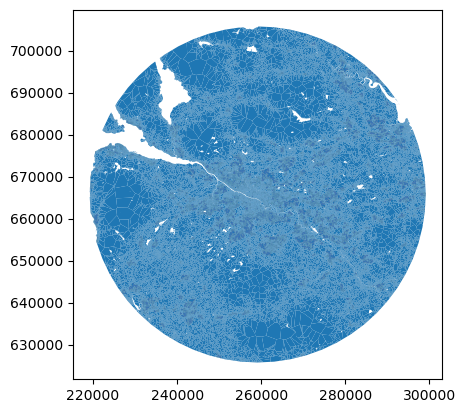

In [ ]:
tessellation.plot()

In [ ]:
Daskcluster.close()
client.shutdown()

In [ ]:
tessellation[tessellation.duplicated('uID', keep=False)]

,uID,geometry
3352,453362.0,"MULTIPOLYGON (((249825.071 627265.292, 249824...."
9544,242824.0,"POLYGON ((268959.646 662964.924, 268960.158 66..."
9545,333225.0,"POLYGON ((268960.158 662964.757, 268959.646 66..."
10088,242824.0,"POLYGON ((268859.533 662777.478, 268847.007 66..."
10090,333225.0,"POLYGON ((268942.370 662970.497, 268941.869 66..."
...,...,...
559139,158630.0,"POLYGON ((257482.388 668103.838, 257472.955 66..."
559629,166756.0,"POLYGON ((233496.743 673601.662, 233489.223 67..."
559665,92668.0,"POLYGON ((239134.829 675596.763, 239151.704 67..."
559843,395700.0,"POLYGON ((290639.959 682081.129, 290641.463 68..."


In [ ]:
# Convert the 'uID' column of buildings to a set for efficient lookups
uIDs_buildings = set(buildings['uID'])

# Filter the tesellation GeoDataFrame to keep only rows with uID in buildings
tessellation = tessellation[tessellation['uID'].isin(uIDs_buildings)]


In [ ]:
tessellation.sort_values(by='uID').reset_index(drop=True)

,uID,geometry
0,0.0,"POLYGON ((261508.200 702073.285, 261508.061 70..."
1,1.0,"POLYGON ((245280.364 702431.549, 245280.098 70..."
2,2.0,"POLYGON ((261473.814 702178.805, 261473.601 70..."
3,3.0,"POLYGON ((251871.181 700273.852, 251871.000 70..."
4,4.0,"POLYGON ((251985.968 701038.007, 251986.735 70..."
...,...,...
550856,550836.0,"POLYGON ((262092.010 653498.112, 262092.083 65..."
550857,550837.0,"POLYGON ((281042.289 653730.804, 281042.152 65..."
550858,550838.0,"POLYGON ((262300.409 653843.540, 262299.887 65..."
550859,550839.0,"POLYGON ((280393.090 649704.830, 280389.336 64..."


In [ ]:
tessellation = tessellation[["uID", "geometry"]]
buildings = buildings[["uID", "geometry"]]

In [ ]:
tessellation.to_parquet(f"./output/{place}/tessellation_p1.pq")

In [ ]:
buildings.to_parquet(f"./output/{place}/buildings_p1.pq")